In [1]:
# import libraries
import sys
sys.path.extend('..')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
sns.set()
from IPython.display import display
pd.options.display.max_columns = None

%matplotlib inline
# random seed for reproducibility
np.random.seed(42)

In [2]:
# other imports
from glcdataset import build_environmental_data, get_taxref_names
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

## Analyzing PL Trusted dataset (subset of 5000 first samples).

### Looking at the data

In [4]:
df = pd.read_csv('~/dev/geolifeclef/GLC19/example_occurrences.csv',
             sep=';', header='infer', quotechar='"', low_memory=True)

df = df[['Longitude','Latitude','glc19SpId','scName']]\
       .dropna(axis=0, how='all')\
       .astype({'glc19SpId': 'int64'})

# target pandas series of the species identifiers
target_df = df['glc19SpId'].reset_index(drop=True)

# correspondence table between ids and the species taxonomic names
# (Taxref names with year of discoverie)
taxonomic_names = pd.read_csv('~/dev/geolifeclef/data/occurrences/taxaName_glc19SpId.csv',
                              sep=';',header='infer', quotechar='"',low_memory=True)

# building the environmental data
env_df = build_environmental_data(df[['Latitude','Longitude']],patches_dir='example_envtensors')

# preview data
print('First rows:')
display(env_df.head(5))

First rows:


,Latitude,Longitude,alti,awc_top,bs_top,cec_top,chbio_1,chbio_10,chbio_11,chbio_12,chbio_13,chbio_14,chbio_15,chbio_16,chbio_17,chbio_18,chbio_19,chbio_2,chbio_3,chbio_4,chbio_5,chbio_6,chbio_7,chbio_8,chbio_9,clc,crusting,dgh,dimp,erodi,etp,oc_top,pd_top,proxi_eau_fast,text
0,2.118889,43.95195,189.375,165.0,85.0,7.0,-12.466217,-3.345141,-20.607746,8125.663218,106.742013,9.759096,7.797814,842.211611,211.643305,444.825684,475.215515,7.412403,43.659561,1624.521767,7.182153,-33.170815,18.091880,-16.240276,-18.657431,242.0,5.0,60.0,100.0,4.0,1219.375,1.0,2.0,0.0,2.0
1,-0.592500,45.10639,45.625,120.0,35.0,7.0,-12.408222,-3.445150,-20.432219,9869.395237,134.659912,21.429507,7.896484,1130.457343,293.358946,586.608685,614.536827,7.356425,43.620405,1469.921119,7.090589,-33.049495,17.924845,-17.399369,-18.673230,112.0,3.0,140.0,100.0,5.0,1140.625,1.0,1.0,0.0,1.0
2,-4.534861,48.38958,69.375,0.0,85.0,22.0,-12.654952,-4.049012,-20.301858,10776.452255,164.932879,19.036463,8.747647,1354.776004,278.995202,570.998127,658.569683,6.814127,43.232935,1030.495808,5.632612,-32.310782,16.160860,-17.189342,-19.756796,112.0,3.0,140.0,100.0,0.0,800.625,2.0,2.0,0.0,0.0
3,2.381917,47.11248,144.375,210.0,85.0,22.0,-12.654993,-3.581393,-20.752113,8573.985604,107.302610,20.969791,7.041919,847.053065,304.325389,655.057129,471.030666,7.434147,43.595905,1578.880932,7.098260,-33.448856,18.231026,-17.786134,-21.818259,112.0,3.0,140.0,100.0,2.0,1075.625,4.0,2.0,0.0,3.0
4,2.343150,48.87488,23.125,0.0,85.0,22.0,-12.730834,-3.705430,-20.796891,7828.047793,101.580980,18.518098,7.031616,782.651259,277.788871,646.672261,433.974736,7.360307,43.467027,1533.218632,6.847007,-33.527560,18.081696,-17.837738,-20.024844,111.0,3.0,140.0,100.0,0.0,1006.875,2.0,2.0,0.0,0.0


In [4]:
# describe data
# TODO : look at which variables are numbers, which are categorical
print('Describe env data:')
display(env_df.describe())

print('Describe classes:')
display(target_df.describe())

n_classes = len(target_df.unique())
print('Number of classes: ',n_classes)

Describe env data:


,Latitude,Longitude,alti,awc_top,bs_top,cec_top,chbio_1,chbio_10,chbio_11,chbio_12,chbio_13,chbio_14,chbio_15,chbio_16,chbio_17,chbio_18,chbio_19,chbio_2,chbio_3,chbio_4,chbio_5,chbio_6,chbio_7,chbio_8,chbio_9,clc,crusting,dgh,dimp,erodi,etp,oc_top,pd_top,proxi_eau_fast,text
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,2.530429,46.302669,238.331000,137.122400,71.623000,12.568400,-12.608366,-3.569089,-20.676749,8958.203670,127.020554,15.925165,7.936435,1012.349896,258.736963,573.888203,488.819315,7.278715,43.414662,1539.890593,6.795527,-33.226302,17.812826,-17.151195,-19.976093,180.573600,3.151000,125.250000,96.634000,2.724800,1008.193750,2.134600,1.432600,0.108800,1.805000
std,2.999031,2.300240,415.308171,69.753395,20.834819,7.682703,0.304610,0.336300,0.354276,1799.296724,24.121874,10.141819,0.939501,204.020008,90.751464,223.526008,106.341950,0.155870,0.218042,169.640466,0.371390,0.540276,0.492755,0.779578,1.611015,86.539942,1.298051,36.839774,11.984939,1.688915,206.813311,1.298314,0.571597,0.311419,1.277381
min,-4.767943,41.394454,-34.375000,-1.000000,30.000000,0.000000,-14.469669,-5.411680,-22.558296,5494.840584,82.793863,-9.839475,6.734637,624.710811,23.158748,33.665955,248.427869,6.757600,42.584645,991.671304,4.770478,-35.576720,15.962938,-19.697410,-24.979209,111.000000,-1.000000,10.000000,50.000000,-1.000000,133.125000,0.000000,0.000000,0.000000,-1.000000
25%,0.321712,44.031053,17.812500,120.000000,62.000000,7.000000,-12.760109,-3.766906,-20.842948,7725.321975,109.175546,12.422409,7.148145,862.749357,224.909222,453.795556,413.110308,7.175082,43.279954,1475.578925,6.671180,-33.545400,17.506283,-17.812406,-21.399783,112.000000,3.000000,140.000000,100.000000,2.000000,960.625000,1.000000,1.000000,0.000000,1.000000
50%,2.432091,46.178205,96.875000,165.000000,85.000000,7.000000,-12.637356,-3.619502,-20.682933,8627.653840,125.247189,16.512279,7.631462,1004.835726,259.666623,562.171341,467.121221,7.355561,43.448863,1543.165660,6.873405,-33.294417,18.019002,-17.351331,-19.320963,112.000000,3.000000,140.000000,100.000000,3.000000,1030.625000,2.000000,1.000000,0.000000,2.000000
75%,4.999299,48.496167,259.375000,165.000000,85.000000,22.000000,-12.427946,-3.365404,-20.431438,9716.773218,139.830056,20.709778,8.524765,1122.536864,298.786436,684.147866,547.417510,7.389774,43.557032,1652.413958,7.031631,-32.858967,18.147134,-16.425736,-18.657896,242.000000,4.000000,140.000000,100.000000,4.000000,1134.375000,2.000000,2.000000,0.000000,3.000000
max,9.512058,51.069080,3525.625000,210.000000,85.000000,50.000000,-11.729125,-2.675245,-19.703304,17823.497832,229.798681,57.950723,10.821936,1842.999005,666.333689,1699.750479,1006.713453,7.468608,44.125609,2039.330787,7.415353,-31.645671,18.681399,-15.085256,-17.551242,523.000000,5.000000,140.000000,100.000000,5.000000,1250.625000,8.000000,2.000000,1.000000,8.000000


Describe classes:


count     5000.000000
mean     31038.085000
std       1080.794907
min      29968.000000
25%      30230.000000
50%      30687.000000
75%      31347.000000
max      34332.000000
Name: glc19SpId, dtype: float64

Number of classes:  633


In [5]:
# analyzing overlapping entries
dupl_env_df = env_df[env_df.duplicated(subset=['Latitude','Longitude'],keep=False)]
# dupl_target_df = target_df.loc[dupl_env_df.index]
print('Describe duplicated entries:')
display(dupl_env_df.describe())

perc_dupl_samples = len(dupl_env_df)/len(env_df)
print(f'{perc_dupl_samples}% of samples overlap with at least another sample')

Describe duplicated entries:


,Latitude,Longitude,alti,awc_top,bs_top,cec_top,chbio_1,chbio_10,chbio_11,chbio_12,chbio_13,chbio_14,chbio_15,chbio_16,chbio_17,chbio_18,chbio_19,chbio_2,chbio_3,chbio_4,chbio_5,chbio_6,chbio_7,chbio_8,chbio_9,clc,crusting,dgh,dimp,erodi,etp,oc_top,pd_top,proxi_eau_fast,text
count,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000
mean,2.488271,45.855321,271.544540,121.275862,70.206897,12.482759,-12.580242,-3.527603,-20.656816,9084.030631,128.700616,15.611925,7.942767,1027.660528,257.448195,572.769168,499.403055,7.291121,43.430275,1553.797187,6.842326,-33.221743,17.848223,-17.094556,-19.738771,183.195402,2.908046,117.356322,92.988506,2.310345,980.366379,1.977011,1.425287,0.045977,1.574713
std,2.912811,2.115718,597.116206,75.884504,22.951485,8.300829,0.382589,0.384798,0.428675,1673.182132,22.841337,9.539043,0.844955,189.112153,86.822310,224.402008,86.942997,0.125676,0.193100,137.123685,0.364075,0.602993,0.374848,0.832708,1.714136,99.426593,1.596742,44.655263,16.920810,1.850898,283.278674,1.275685,0.675694,0.210649,1.360849
min,-2.494148,41.886303,-29.375000,-1.000000,30.000000,0.000000,-14.021818,-4.891401,-22.143804,6224.969968,87.640106,-8.009541,6.823745,668.326714,55.277261,99.788061,356.686280,6.959625,42.879996,1271.921492,5.352442,-35.057884,17.008065,-19.264955,-24.357647,111.000000,-1.000000,10.000000,50.000000,-1.000000,133.125000,0.000000,0.000000,0.000000,-1.000000
25%,0.042749,43.873030,24.375000,0.000000,35.000000,7.000000,-12.715188,-3.698652,-20.806891,8073.779730,112.395306,12.385451,7.225961,896.304877,221.860330,462.144489,443.299039,7.208141,43.357149,1484.420518,6.729127,-33.519313,17.548666,-17.764168,-21.281763,112.000000,2.000000,140.000000,100.000000,0.000000,986.875000,1.000000,1.000000,0.000000,0.000000
50%,2.666451,45.683620,69.375000,165.000000,85.000000,7.000000,-12.569025,-3.567573,-20.588984,8761.091823,130.061218,16.423510,7.677205,1029.683147,258.757197,528.325412,481.588693,7.353700,43.450753,1570.735534,6.894042,-33.237321,17.987904,-17.297287,-18.964767,121.000000,3.000000,140.000000,100.000000,3.000000,1055.625000,2.000000,2.000000,0.000000,2.000000
75%,4.604715,47.586480,253.125000,165.000000,85.000000,22.000000,-12.351083,-3.371227,-20.405213,9966.548130,138.696538,19.628594,8.476360,1123.576400,297.076141,725.185384,560.945786,7.389471,43.546427,1652.089936,7.087295,-32.816648,18.122493,-16.418799,-18.695435,242.000000,4.000000,140.000000,100.000000,4.000000,1141.875000,2.000000,2.000000,0.000000,2.000000
max,8.803104,50.499880,2905.625000,210.000000,85.000000,22.000000,-11.755047,-2.700808,-19.730702,14880.972185,184.966121,46.219783,10.391692,1440.234926,557.366528,1323.947939,716.234822,7.443465,43.774051,1830.091882,7.267004,-31.677030,18.411757,-15.555226,-17.777837,512.000000,5.000000,140.000000,100.000000,5.000000,1239.375000,4.000000,2.000000,1.000000,4.000000


0.0174% of samples overlap with at least another sample


**One hot encoding of categorical feature 'clc'**

In [7]:
# from glcdataset import encode_categorical_feature_fit
# from sklearn.preprocessing import OneHotEncoder
# 
#  create an encoder object and fit it the the column data
# encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
# 
# env_df_encoded = encode_categorical_feature_fit(env_df, encoder=encoder)
# 
# display(env_df_encoded)

## Plotting observations on a map

In [8]:
# Plotly imports
import plotly 
import plotly.plotly as py
import plotly.graph_objs as go

# using cufflinks plotly + cufflinks in offline mode
from plotly.offline import iplot, init_notebook_mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

/anaconda3/lib/python3.6/site-packages/plotly/graph_objs/_deprecations.py:558: DeprecationWarning:

plotly.graph_objs.YAxis is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.YAxis
  - plotly.graph_objs.layout.scene.YAxis


/anaconda3/lib/python3.6/site-packages/plotly/graph_objs/_deprecations.py:531: DeprecationWarning:

plotly.graph_objs.XAxis is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.XAxis
  - plotly.graph_objs.layout.scene.XAxis




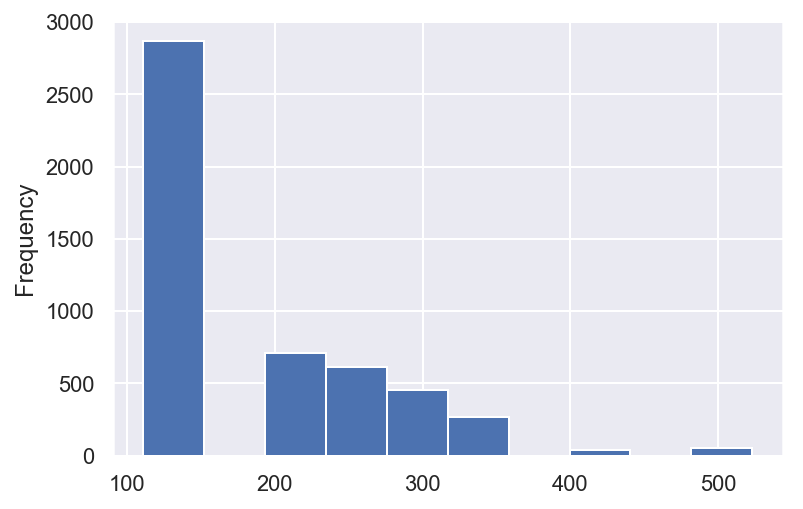

In [10]:
env_df['clc'].plot(kind='hist')
plt.show()

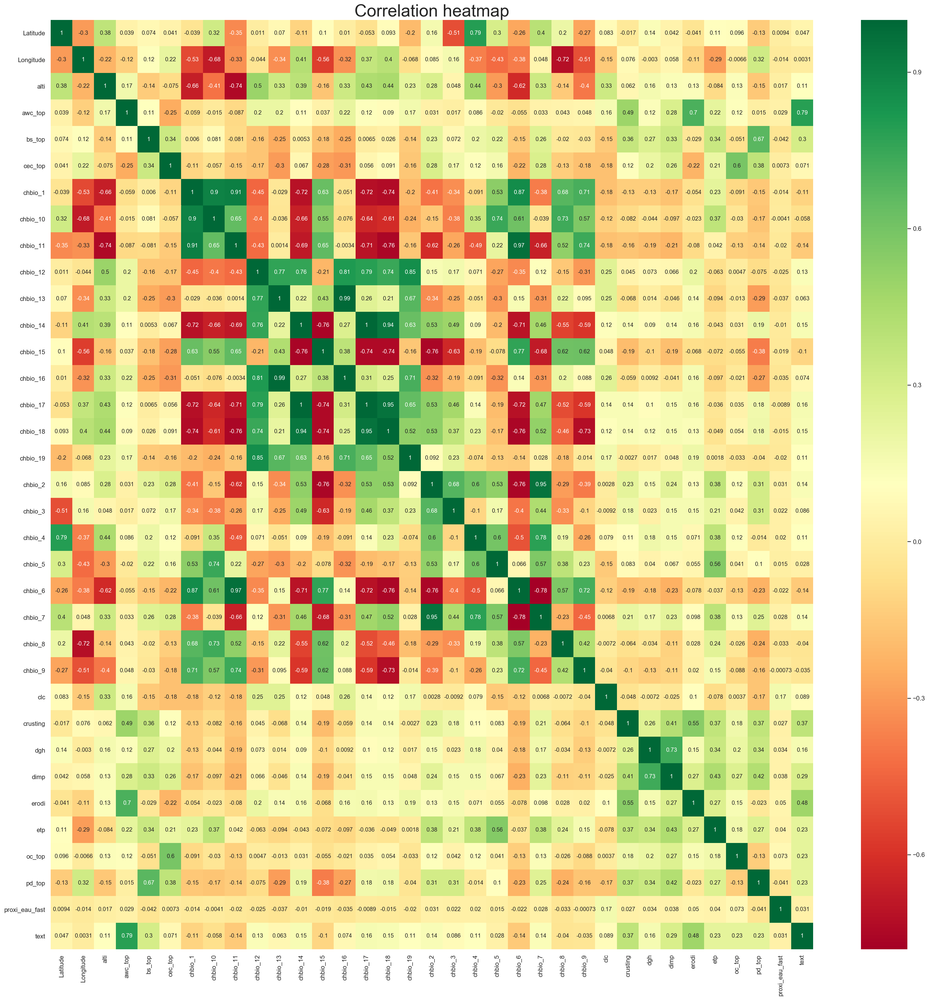

In [34]:
# show the correlations of the individual features
plt.figure(figsize=(30,30))
corr = env_df.corr()
corr.index = env_df.columns
sns.heatmap(corr, annot=True, cmap='RdYlGn')
plt.title("Correlation heatmap", fontsize=30)
plt.show()

<Figure size 2160x2160 with 0 Axes>

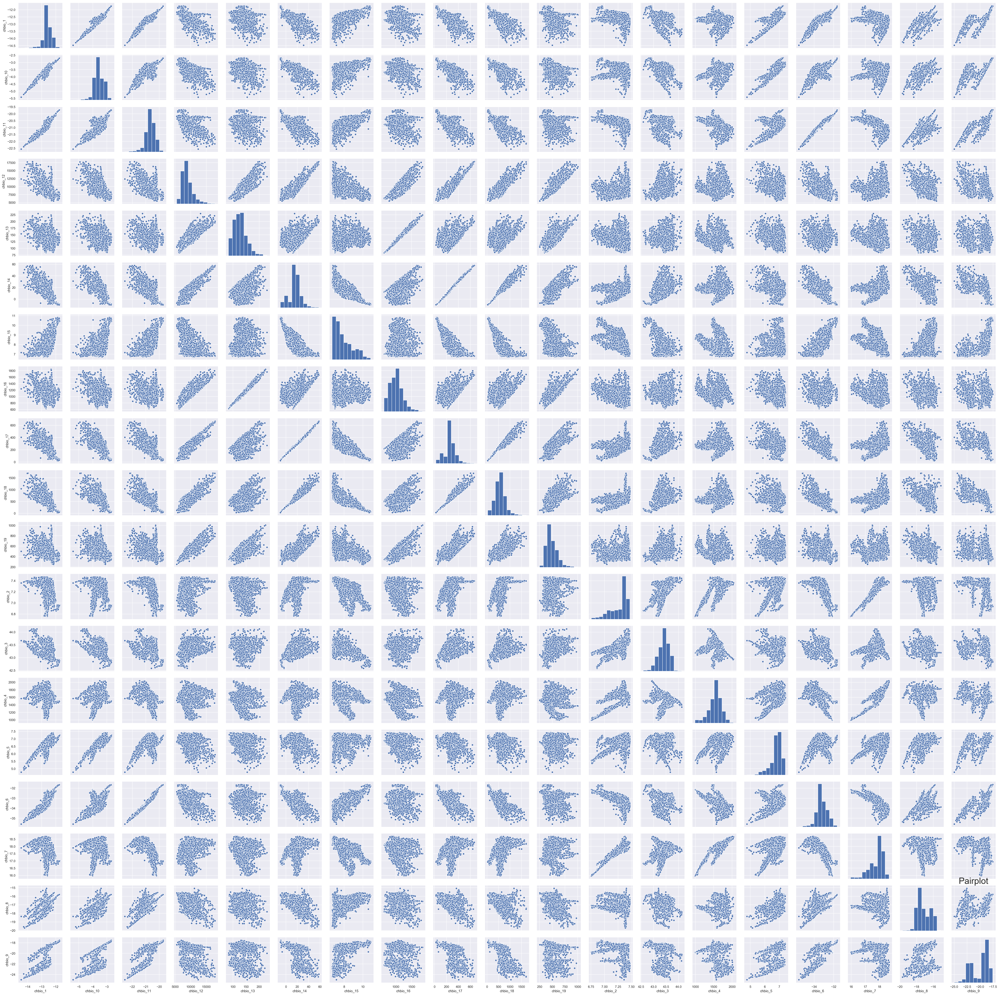

In [38]:
# show pairplot of some variables
plt.figure(figsize=(30,30))
subset_features = [c for c in list(env_df.columns) if c.startswith('chbio')]
sns.pairplot(env_df[subset_features])
plt.title("Pairplot", fontsize=30)
plt.show()

Principal component analysis:

Variance kept: 0.99%
Number of components: 21
Explained variance ratio of each components:
[0.27931984 0.15136252 0.12126717 0.08930569 0.06535042 0.05108632
 0.04134438 0.03368107 0.02857266 0.02607278 0.01993482 0.01797022
 0.01419084 0.01122724 0.00823602 0.007461   0.00673111 0.00656846
 0.00461079 0.00400334 0.00350265]



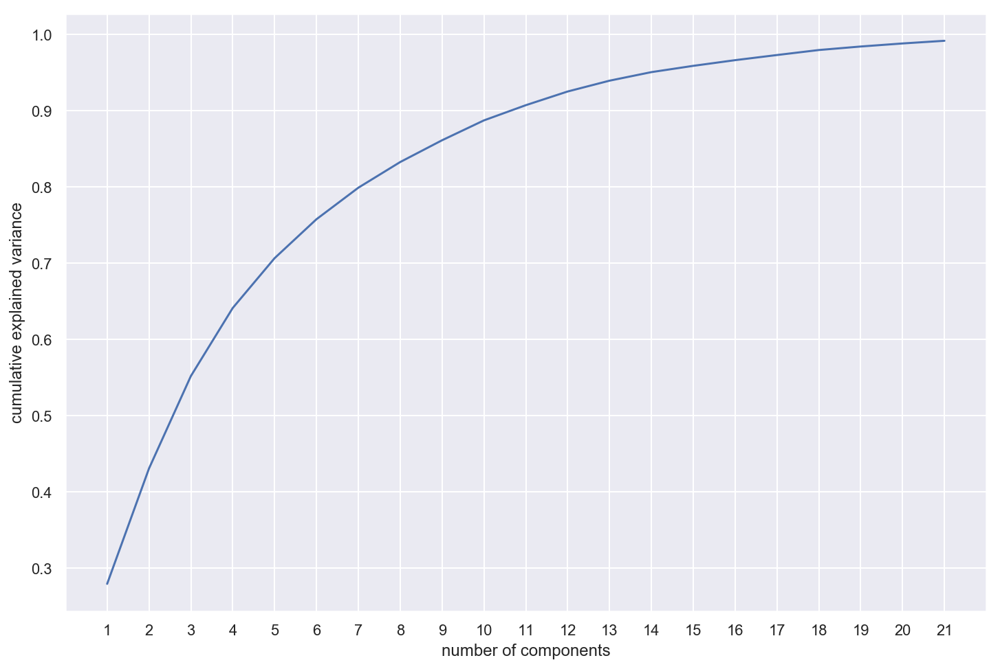

In [36]:
# get env df values
X = env_df.values
# Standardize the features by removing the mean and scaling to unit variance
# feature columns in data
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Reduce the data using principal component analysis, finding the number of principal
# components to keep variance

explained_variance_ratio=0.99
pca = PCA(n_components=explained_variance_ratio)
X_pca = pca.fit_transform(X)
print("Principal component analysis:\n")
n_components = pca.n_components_
print(f'Variance kept: {explained_variance_ratio}%')
print(f'Number of components: {pca.n_components_}')
print(f'Explained variance ratio of each components:\n{pca.explained_variance_ratio_}\n')

# looking at the cumulative explained variance ratio
# by the number of components
plt.figure(figsize=(12,8))
plt.plot(np.arange(1,n_components+1),np.cumsum(pca.explained_variance_ratio_))
#plt.step(np.arange(1,n_components+1), np.cumsum(pca.explained_variance_ratio_),where='mid')

plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.xticks(np.arange(1,n_components+1))
plt.show()


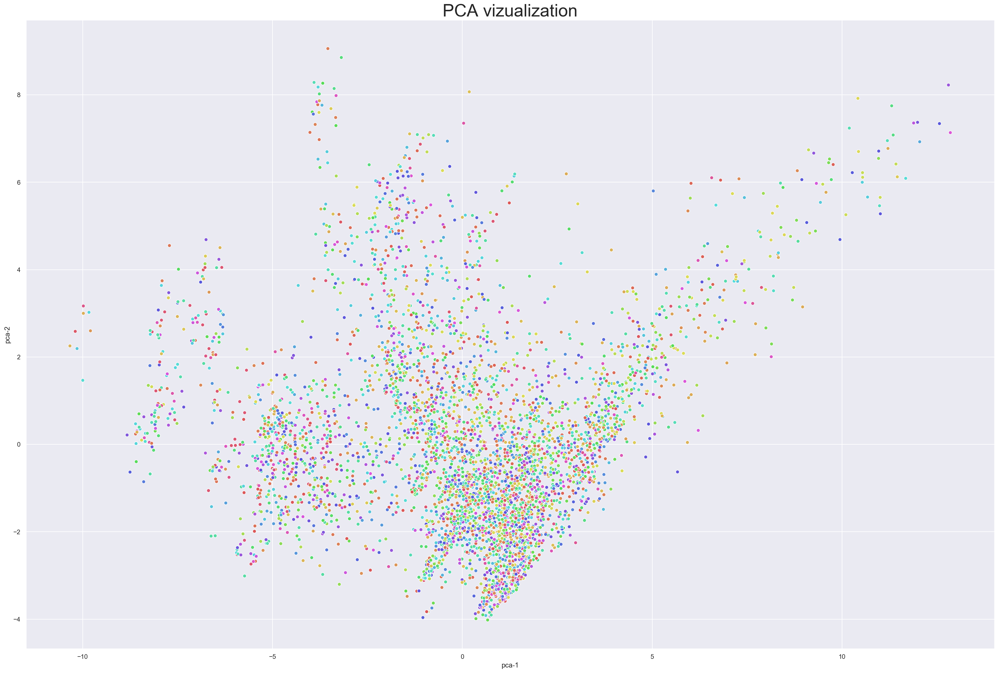

In [149]:
# Visualization of PCA
df_pca = pd.DataFrame({'glc19SpId':target_df})

for i_pca in range(0,n_components):
    df_pca['pca-'+str(i_pca+1)] = X_pca[:,i_pca]

plt.figure(figsize=(30,20))
sns.scatterplot(
    x="pca-1", y="pca-2",
    hue="glc19SpId",
    palette=sns.color_palette("hls", n_classes),
    data=df_pca,
    legend=False,
    alpha=1
)
plt.title('PCA vizualization', fontsize=30)
plt.show()

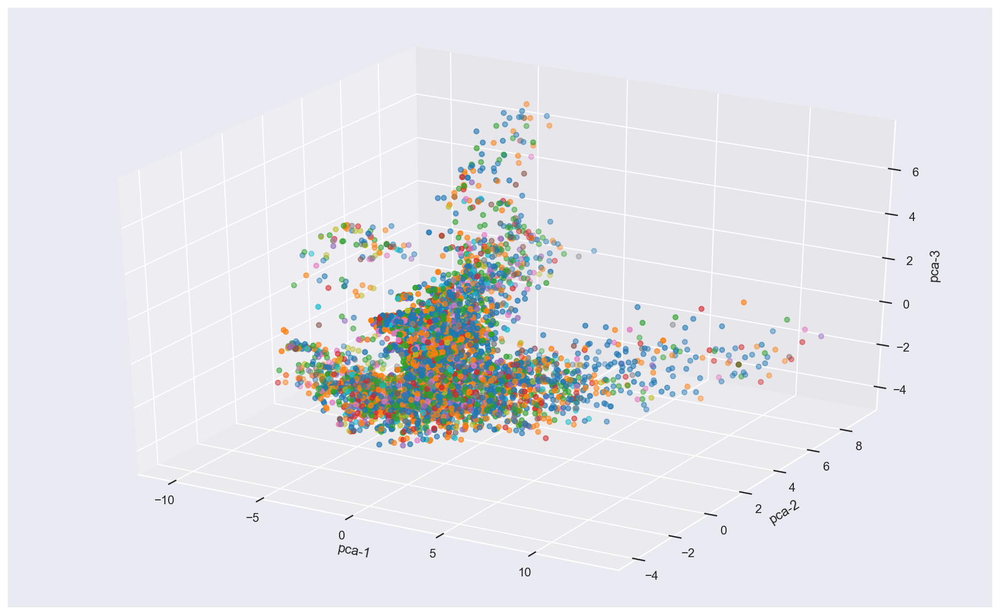

In [125]:
ax = plt.figure(figsize=(16,10)).gca(projection='3d')
ax.scatter(
    xs=df_pca["pca-1"], 
    ys=df_pca["pca-2"], 
    zs=df_pca["pca-3"], 
    c=df_pca["glc19SpId"], 
    cmap='tab10'
)
ax.set_xlabel('pca-1')
ax.set_ylabel('pca-2')
ax.set_zlabel('pca-3')
plt.show()

In [127]:
# Use TSNE to visualize data in two-dimensional space
from sklearn.manifold import TSNE
X_tsne = TSNE(verbose=1).fit_transform(X_pca)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5000 samples in 0.005s...
[t-SNE] Computed neighbors for 5000 samples in 0.722s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5000
[t-SNE] Computed conditional probabilities for sample 2000 / 5000
[t-SNE] Computed conditional probabilities for sample 3000 / 5000
[t-SNE] Computed conditional probabilities for sample 4000 / 5000
[t-SNE] Computed conditional probabilities for sample 5000 / 5000
[t-SNE] Mean sigma: 0.868861
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.082085
[t-SNE] KL divergence after 1000 iterations: 0.674182


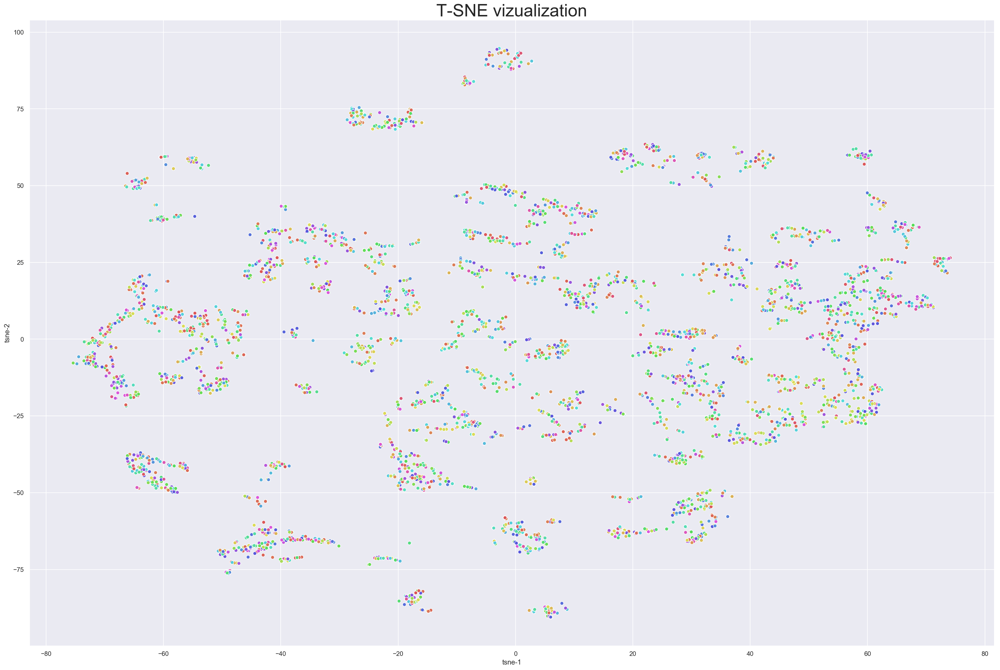

In [138]:
# Visualization of T-SNE in two dimension

df_tsne = pd.DataFrame({'glc19SpId':target_df})

df_tsne['tsne-1'] = X_tsne[:,0]
df_tsne['tsne-2'] = X_tsne[:,1]

plt.figure(figsize=(30,20))
sns.scatterplot(
    x="tsne-1", y="tsne-2",
    hue="glc19SpId",
    palette=sns.color_palette("hls", n_classes),
    data=df_tsne,
    legend=False,
    alpha=1
)
plt.title('T-SNE visualization', fontsize=30)
plt.show()

## T-SNE

t-distributed stochastic neighbor embedding (t-SNE) is another technique for dimensionality reduction and is particularly well suited for the visualization of high-dimensional datasets.
Contrary to PCA it is not a linear algebra technique but a probablistic one.

t-SNE minimizes the Kullback-Leibler divergence between two joint distributions : a distribution that measures pairwise similarities of the input objects and a distribution that measures pairwise similarities of the corresponding low-dimensional points in the embedding.

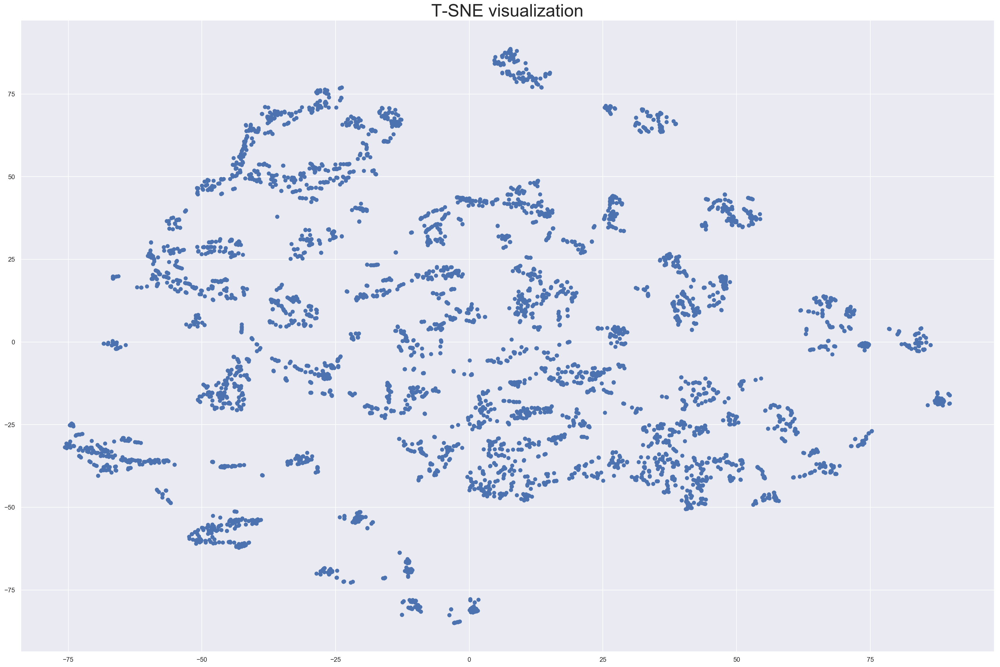

In [145]:
plt.figure(figsize=(30,20))
plt.scatter(*projection.T)
plt.title('T-SNE visualization', fontsize=30)
plt.show()

### TO DO : Zipf law plot:

Maybe the data contains a lot of common species?  
Try to plot number of species considered by the percent of species in the dataset